# Mini Project 2: Linear regression on a non linear data set

## Project question

Can a linear regression model be built to predict the price of an airbnb in New York?

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import seaborn as sns
import folium
import plotly.express as px

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
# Cause plots to be displayed in the notebook:
%pylab inline
%matplotlib inline

Populating the interactive namespace from numpy and matplotlib


Columns:

id: listing ID

name: name of the listing

host_id: host ID

host_name: name of the host

neighbourhood_group: location

neighbourhood: area

latitude: latitude coordinates

longitude: longitude coordinates

room_type: listing space type

price: price in dollars

minimum_nights: amount of nights minimum

number_of_reviews: number of reviews

last_review: latest review

reviews_per_month: number of reviews per month

calculated_host_listings_count: amount of listing per host

availability_365: number of days when listing is available for booking

In [2]:
#https://www.kaggle.com/dgomonov/new-york-city-airbnb-open-data
nycbnb = pd.read_csv('data/AB_NYC_2019.csv')
nycbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [3]:
df=nycbnb

In [4]:
nycbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
id                                48895 non-null int64
name                              48879 non-null object
host_id                           48895 non-null int64
host_name                         48874 non-null object
neighbourhood_group               48895 non-null object
neighbourhood                     48895 non-null object
latitude                          48895 non-null float64
longitude                         48895 non-null float64
room_type                         48895 non-null object
price                             48895 non-null int64
minimum_nights                    48895 non-null int64
number_of_reviews                 48895 non-null int64
last_review                       38843 non-null object
reviews_per_month                 38843 non-null float64
calculated_host_listings_count    48895 non-null int64
availability_365                  48895 non-null int64

In [5]:
nycbnb.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

In [6]:
nycbnb.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [7]:
nycbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [8]:
nycorr = nycbnb.corr()
nycorr

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
id,1.000000,0.588290,-0.003125,0.090908,0.010619,-0.013224,-0.319760,0.291828,0.133272,0.085468
host_id,0.588290,1.000000,0.020224,0.127055,0.015309,-0.017364,-0.140106,0.296417,0.154950,0.203492
latitude,-0.003125,0.020224,1.000000,0.084788,0.033939,0.024869,-0.015389,-0.010142,0.019517,-0.010983
longitude,0.090908,0.127055,0.084788,1.000000,-0.150019,-0.062747,0.059094,0.145948,-0.114713,0.082731
price,0.010619,0.015309,0.033939,-0.150019,1.000000,0.042799,-0.047954,-0.030608,0.057472,0.081829
minimum_nights,-0.013224,-0.017364,0.024869,-0.062747,0.042799,1.000000,-0.080116,-0.121702,0.127960,0.144303
number_of_reviews,-0.319760,-0.140106,-0.015389,0.059094,-0.047954,-0.080116,1.000000,0.549868,-0.072376,0.172028
reviews_per_month,0.291828,0.296417,-0.010142,0.145948,-0.030608,-0.121702,0.549868,1.000000,-0.009421,0.185791
calculated_host_listings_count,0.133272,0.154950,0.019517,-0.114713,0.057472,0.127960,-0.072376,-0.009421,1.000000,0.225701
availability_365,0.085468,0.203492,-0.010983,0.082731,0.081829,0.144303,0.172028,0.185791,0.225701,1.000000


/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/numpy/lib/histograms.py:839: RuntimeWarning:

invalid value encountered in greater_equal

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/numpy/lib/histograms.py:840: RuntimeWarning:

invalid value encountered in less_equal



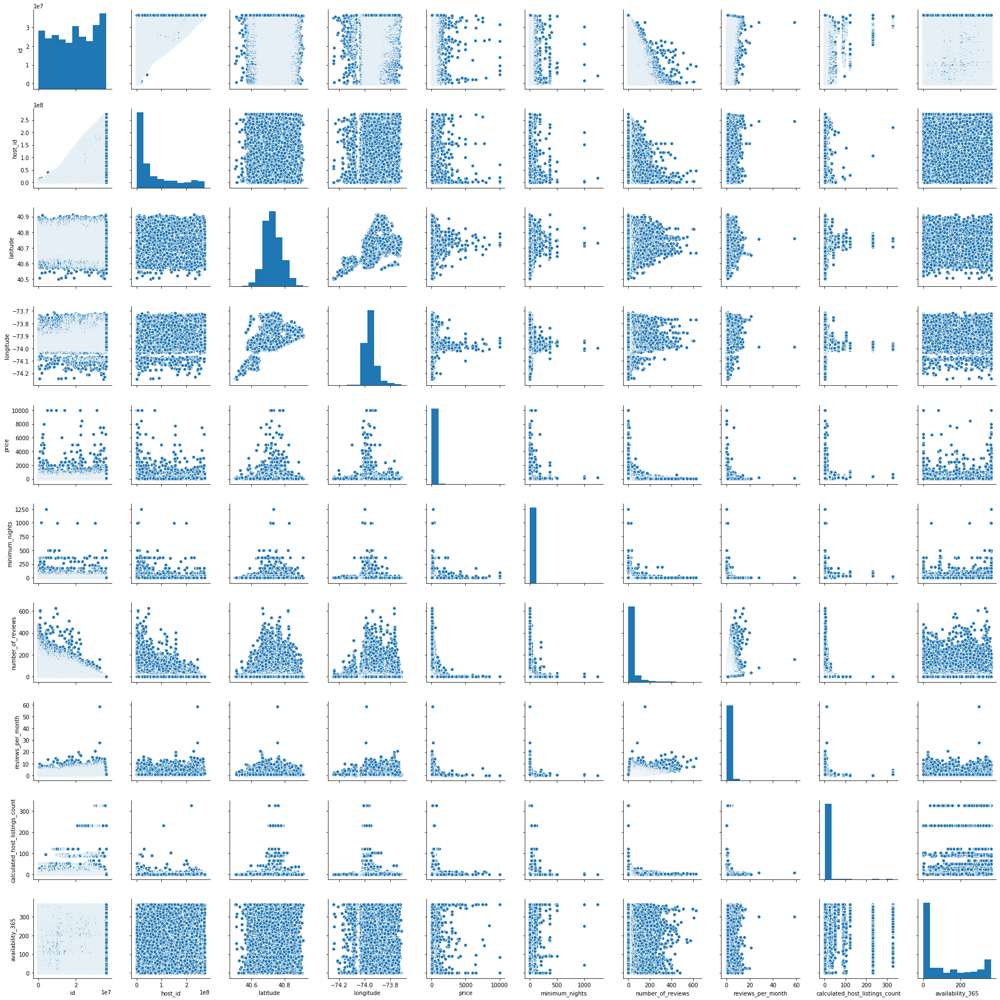

In [9]:
sns.pairplot(nycbnb)

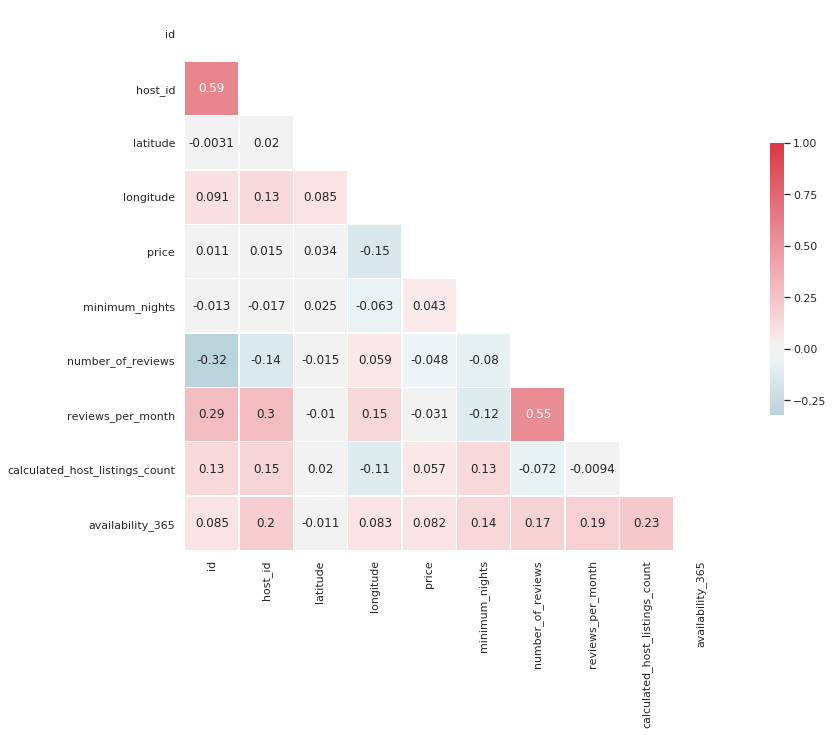

In [10]:
# Copied code from seaborn examples
# https://seaborn.pydata.org/examples/many_pairwise_correlations.html
sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.zeros_like(nycorr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 10))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(nycorr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.show();

At first glance, there is really weak correlation between any of the variables with the exception of reviews per month with number of reviews and host id with id.

In [11]:
def generateBaseMap(default_location=[40.7128, -74.0060], default_zoom_start=10):
    '''
    Create a base map
    '''
    base_map = folium.Map(
        location = default_location
        , control_scale = True
        , zoom_start = default_zoom_start
    )
    
    return base_map

In [12]:
base_map = generateBaseMap()
display(base_map)

In [13]:
for i in range(0, len(nycbnb.head(1000))):
    folium.Marker(location=[nycbnb.iloc[i]['latitude'], nycbnb.iloc[i]['longitude']]).add_to(base_map)

In [14]:
display(base_map)

In [15]:
from folium.plugins import HeatMap

heat_base_map = generateBaseMap()
nycbnb['count'] = 1

HeatMap(
    data = nycbnb[['latitude', 'longitude', 'count']].groupby(['latitude', 'longitude']).sum().reset_index().values.tolist()
    , radius=8
    , max_zoom=13
).add_to(heat_base_map)

display(heat_base_map)

In [16]:
nycbnb.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'count'],
      dtype='object')

In [17]:
nycbnb.room_type.unique()

array(['Private room', 'Entire home/apt', 'Shared room'], dtype=object)

In [18]:
nycbnb.neighbourhood_group.unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

In [19]:
nycbnb.neighbourhood.unique()

array(['Kensington', 'Midtown', 'Harlem', 'Clinton Hill', 'East Harlem',
       'Murray Hill', 'Bedford-Stuyvesant', "Hell's Kitchen",
       'Upper West Side', 'Chinatown', 'South Slope', 'West Village',
       'Williamsburg', 'Fort Greene', 'Chelsea', 'Crown Heights',
       'Park Slope', 'Windsor Terrace', 'Inwood', 'East Village',
       'Greenpoint', 'Bushwick', 'Flatbush', 'Lower East Side',
       'Prospect-Lefferts Gardens', 'Long Island City', 'Kips Bay',
       'SoHo', 'Upper East Side', 'Prospect Heights',
       'Washington Heights', 'Woodside', 'Brooklyn Heights',
       'Carroll Gardens', 'Gowanus', 'Flatlands', 'Cobble Hill',
       'Flushing', 'Boerum Hill', 'Sunnyside', 'DUMBO', 'St. George',
       'Highbridge', 'Financial District', 'Ridgewood',
       'Morningside Heights', 'Jamaica', 'Middle Village', 'NoHo',
       'Ditmars Steinway', 'Flatiron District', 'Roosevelt Island',
       'Greenwich Village', 'Little Italy', 'East Flatbush',
       'Tompkinsville', 'Asto

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:447: RuntimeWarning:

invalid value encountered in greater

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:447: RuntimeWarning:

invalid value encountered in less



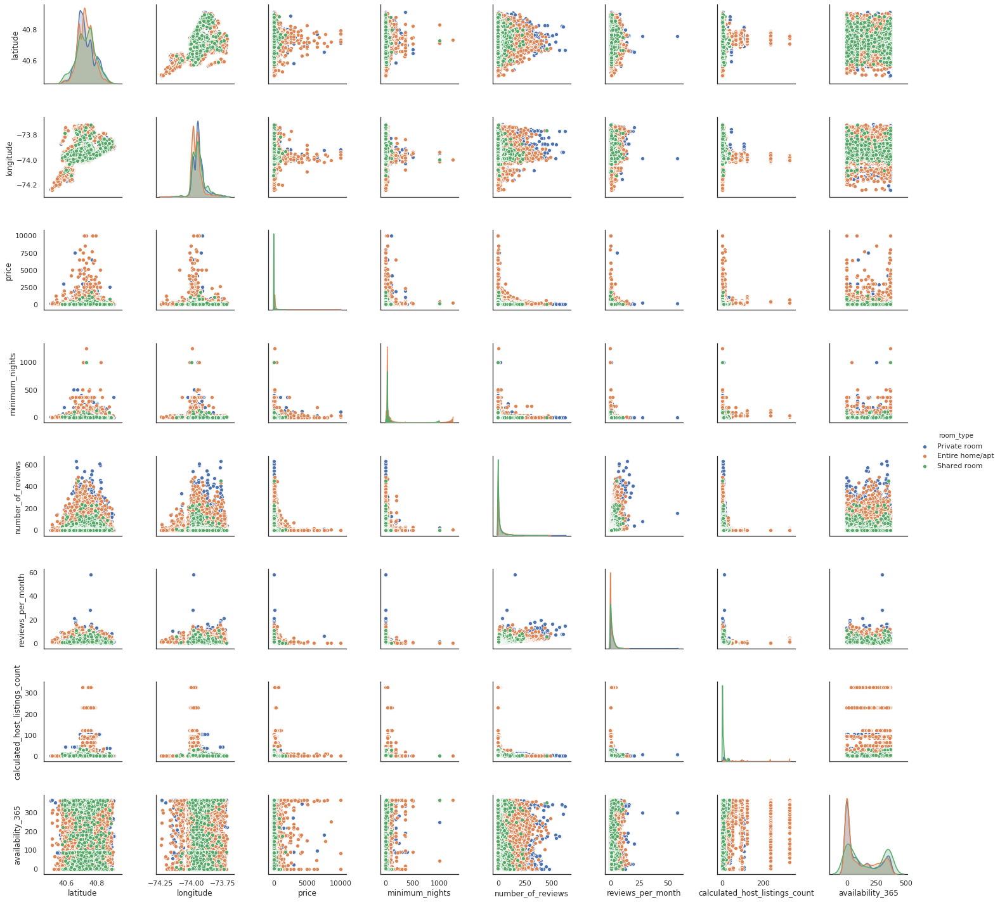

In [20]:
sns.pairplot(nycbnb,hue='room_type',vars = ['latitude', 'longitude', 'price',
       'minimum_nights', 'number_of_reviews',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'])

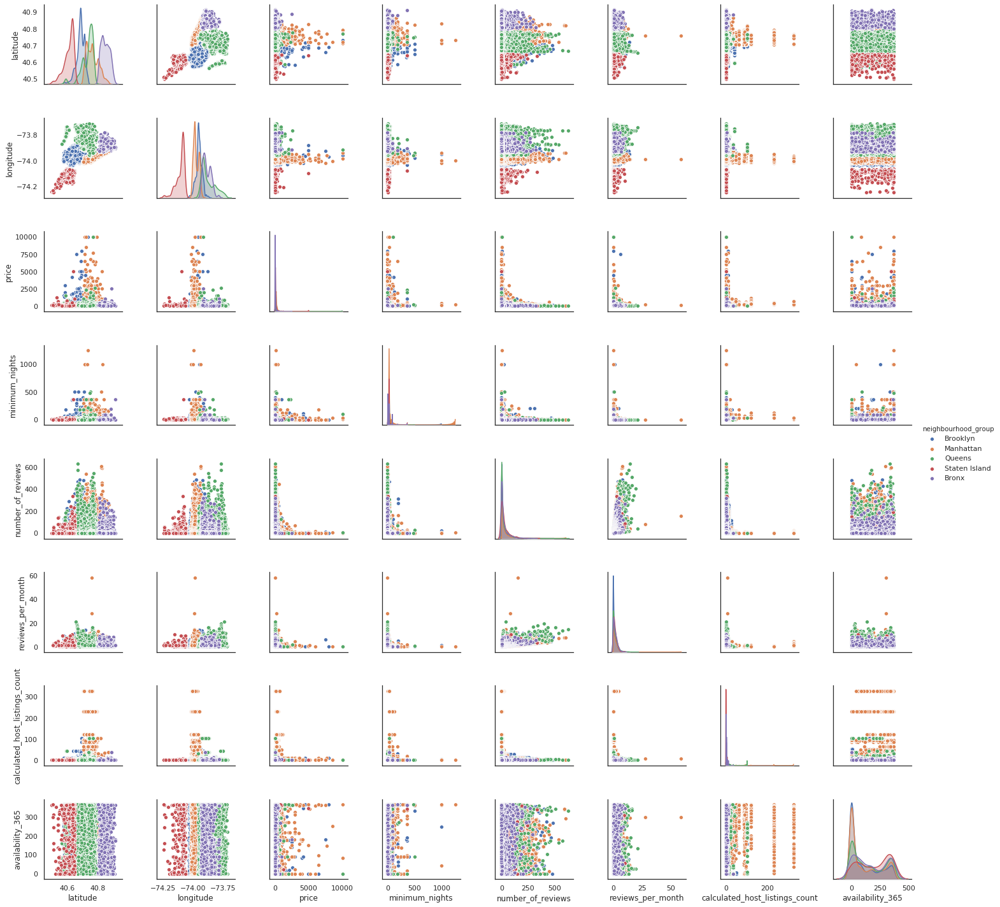

In [21]:
sns.pairplot(nycbnb,hue='neighbourhood_group',vars = ['latitude', 'longitude', 'price',
       'minimum_nights', 'number_of_reviews',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'])

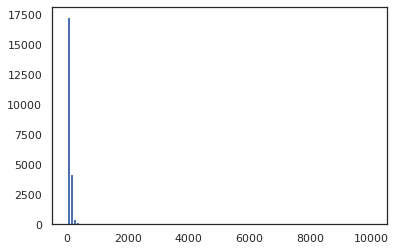

In [22]:
hist = plt.hist(df.price[df.room_type=='Private room'],bins=100)

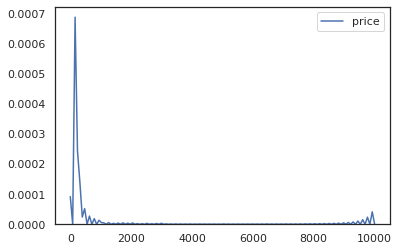

In [23]:
ax = sns.kdeplot(df.price[df.room_type=='Private room'])

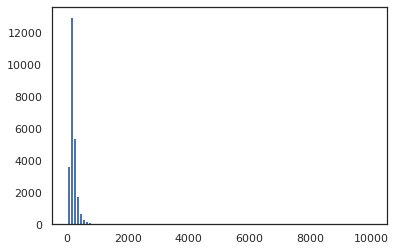

In [24]:
ax1 = plt.hist(df.price[df.room_type=='Entire home/apt'],bins=100)

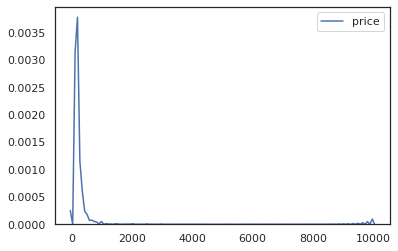

In [25]:
sns.kdeplot(df.price[df.room_type=='Entire home/apt'])

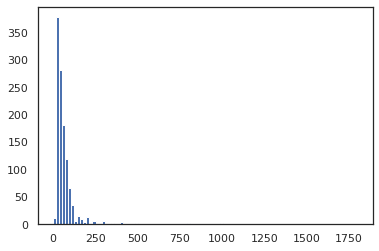

In [26]:
ax2 = plt.hist(df.price[df.room_type=='Shared room'],bins=100)

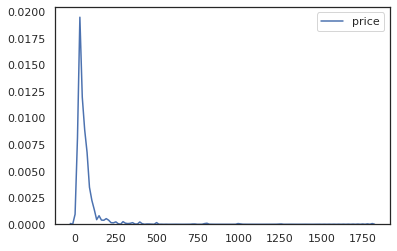

In [27]:
sns.kdeplot(df.price[df.room_type=='Shared room'])

In [28]:
'''
sns.set( palette="muted", color_codes=True)  
rs = np.random.RandomState(10)  

f, axes = plt.subplots(3, 2, figsize=(7, 7), sharex=True)  
sns.distplot(df.price[df.room_type=='Private room'], kde=False, color="b", ax=axes[0, 0])  
sns.distplot(d, hist=False, rug=True, color="r", ax=axes[0, 1])  
sns.distplot(d, hist=False, color="g", kde_kws={"shade": True}, ax=axes[1, 0])  
sns.distplot(d, color="m", ax=axes[1, 1])  
plt.show()  
'''

'\nsns.set( palette="muted", color_codes=True)  \nrs = np.random.RandomState(10)  \n\nf, axes = plt.subplots(3, 2, figsize=(7, 7), sharex=True)  \nsns.distplot(df.price[df.room_type==\'Private room\'], kde=False, color="b", ax=axes[0, 0])  \nsns.distplot(d, hist=False, rug=True, color="r", ax=axes[0, 1])  \nsns.distplot(d, hist=False, color="g", kde_kws={"shade": True}, ax=axes[1, 0])  \nsns.distplot(d, color="m", ax=axes[1, 1])  \nplt.show()  \n'

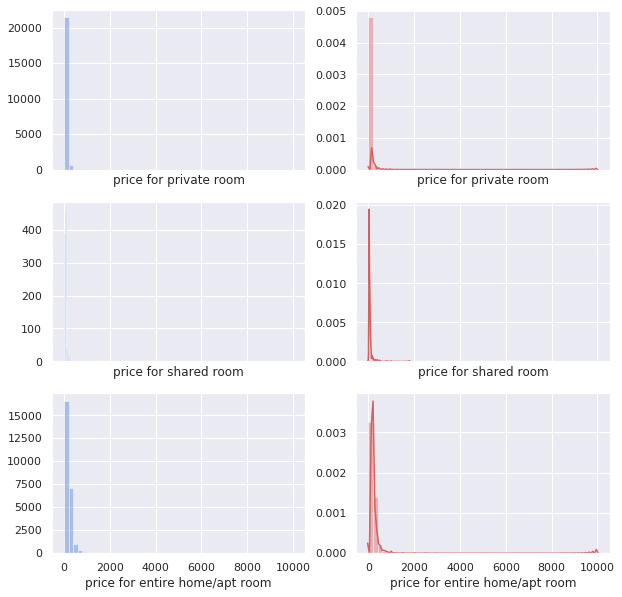

In [29]:
sns.set( palette="muted", color_codes=True)  
rs = np.random.RandomState(10)  

f, axes = plt.subplots(3, 2, figsize=(10, 10), sharex=True)  
sns.distplot(df.price[df.room_type=='Private room'], kde=False, color="b", axlabel = 'price for private room',ax=axes[0, 0])  
sns.distplot(df.price[df.room_type=='Private room'], hist=True,  color="r", axlabel = 'price for private room',ax=axes[0, 1])  
sns.distplot(df.price[df.room_type=='Shared room'],kde=False, color="b", axlabel = 'price for shared room',ax=axes[1, 0])  
sns.distplot(df.price[df.room_type=='Shared room'],hist=True,  color="r", axlabel = 'price for shared room',ax=axes[1, 1])  
sns.distplot(df.price[df.room_type=='Entire home/apt'],kde=False, color="b", axlabel = 'price for entire home/apt room',ax=axes[2, 0])  
sns.distplot(df.price[df.room_type=='Entire home/apt'],hist=True,  color="r", axlabel = 'price for entire home/apt room',ax=axes[2, 1])  
#sns.distplot(d, hist=False, color="g", kde_kws={"shade": True}, ax=axes[1, 0])  
#sns.distplot(d, color="m", ax=axes[1, 1])  
plt.show()  

Based on the above histogram and kde plots, there seems to be no major distinction between the distributions for the price depending on whether it is a shared, entire home/apt room or private room. Shared room has more instances where it is cheaper and less of a tail compared to the other distributions, but nevertheless it is hard to distinguish between the prices at the cheap end of the scale.

In [30]:
df.astype(bool).sum(axis=0)

id                                48895
name                              48895
host_id                           48895
host_name                         48895
neighbourhood_group               48895
neighbourhood                     48895
latitude                          48895
longitude                         48895
room_type                         48895
price                             48884
minimum_nights                    48895
number_of_reviews                 38843
last_review                       48895
reviews_per_month                 48895
calculated_host_listings_count    48895
availability_365                  31362
count                             48895
dtype: int64

In [31]:
df.isna().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
count                                 0
dtype: int64

In [32]:
df_wo_rpm = df.dropna()
df_wo_rpm.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,count
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365,1
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355,1
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194,1
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0,1
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129,1


In [33]:
df_wo_rpm.isna().sum()

id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
count                             0
dtype: int64

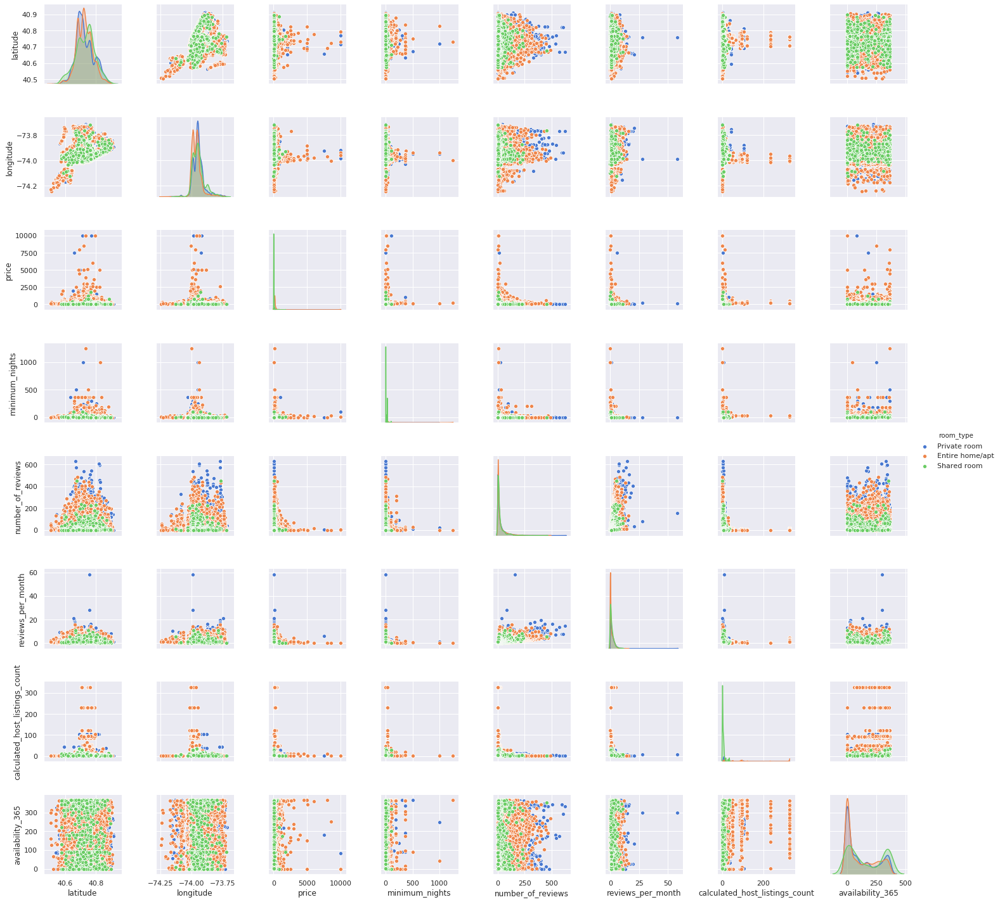

In [34]:
sns.pairplot(df_wo_rpm,hue='room_type',vars = ['latitude', 'longitude', 'price',
       'minimum_nights', 'number_of_reviews',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'])

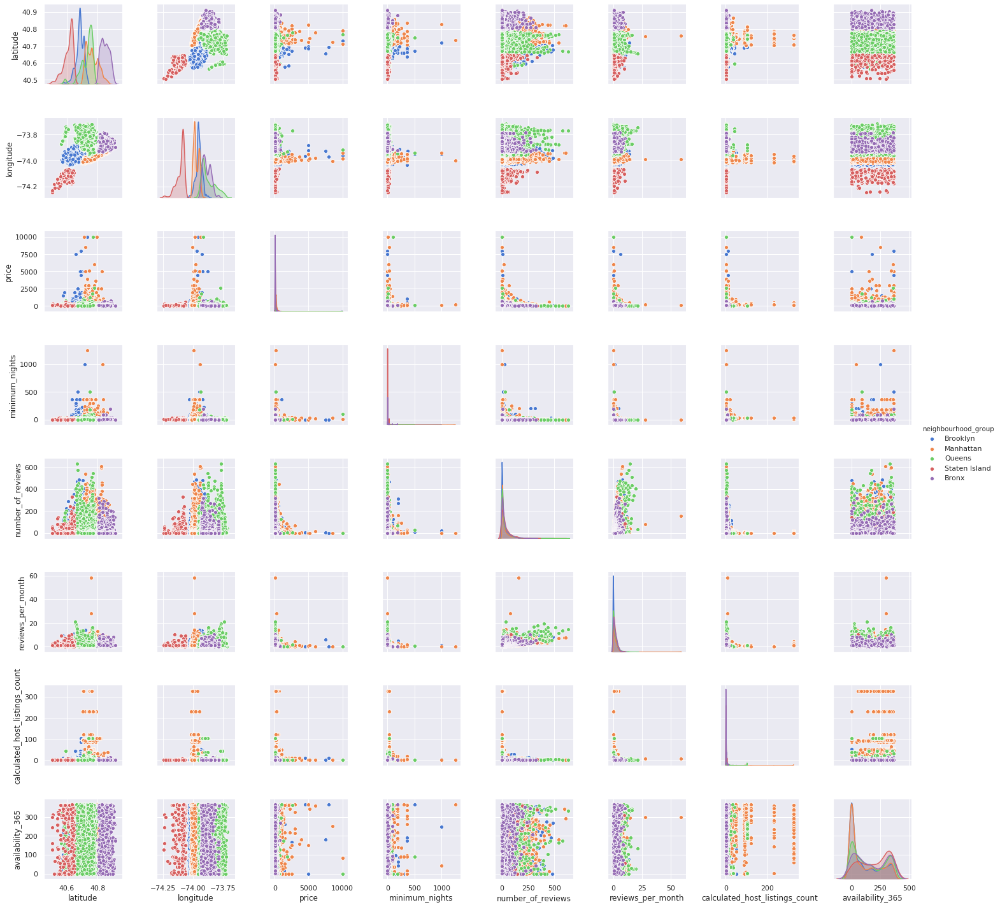

In [35]:
sns.pairplot(df_wo_rpm,hue='neighbourhood_group',vars = ['latitude', 'longitude', 'price',
       'minimum_nights', 'number_of_reviews',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'])

## Regression machine learning models 

#### Linear regression

Initially, just do 80-20 test train split of all features predicting price.

In [36]:
df_wo_rpm.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'count'],
      dtype='object')

In [37]:
features = ['minimum_nights', 'number_of_reviews', 
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365']
X=df_wo_rpm[features]
y=df_wo_rpm.price

In [38]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [39]:
LR_raw = LinearRegression(normalize=False)
LR_norm = LinearRegression(normalize=True)

In [40]:
LR_raw.fit(X_train,y_train)
LR_norm.fit(X_train,y_train)
score_LR_raw = LR_raw.score(X_test,y_test)
score_LR_norm = LR_norm.score(X_test,y_test)
print('Scoring Linear regression with no normalisation:', score_LR_raw)
print('Scoring Linear regression with normalisation:', score_LR_norm)

Scoring Linear regression with no normalisation: 0.010363363652371893
Scoring Linear regression with normalisation: 0.010363363652371893


From the graphs, it is clear there is no linear trend with any of the chosen feature variables and the weak correlations before reaffirmed this. Will need to consider a non linear model.

In [41]:
df_wo_rpm['rec_minimum_nights'] =  df.apply(lambda row: (1./(row.minimum_nights+1.)), axis = 1) 
df_wo_rpm['rec_number_of_reviews'] =  df.apply(lambda row: (1./(row.number_of_reviews+1.)), axis = 1) 
df_wo_rpm['rec_reviews_per_month'] =  df.apply(lambda row: (1./(1.+row.reviews_per_month)), axis = 1) 
df_wo_rpm['rec_calculated_host_listings_count'] =  df.apply(lambda row: (1./(1.+row.calculated_host_listings_count)), axis = 1) 

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in t

In [42]:
df_wo_rpm.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,count,rec_minimum_nights,rec_number_of_reviews,rec_reviews_per_month,rec_calculated_host_listings_count
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,...,9,2018-10-19,0.21,6,365,1,0.500000,0.100000,0.826446,0.142857
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,...,45,2019-05-21,0.38,2,355,1,0.500000,0.021739,0.724638,0.333333
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,...,270,2019-07-05,4.64,1,194,1,0.500000,0.003690,0.177305,0.500000
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,...,9,2018-11-19,0.10,1,0,1,0.090909,0.100000,0.909091,0.500000
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,...,74,2019-06-22,0.59,1,129,1,0.250000,0.013333,0.628931,0.500000


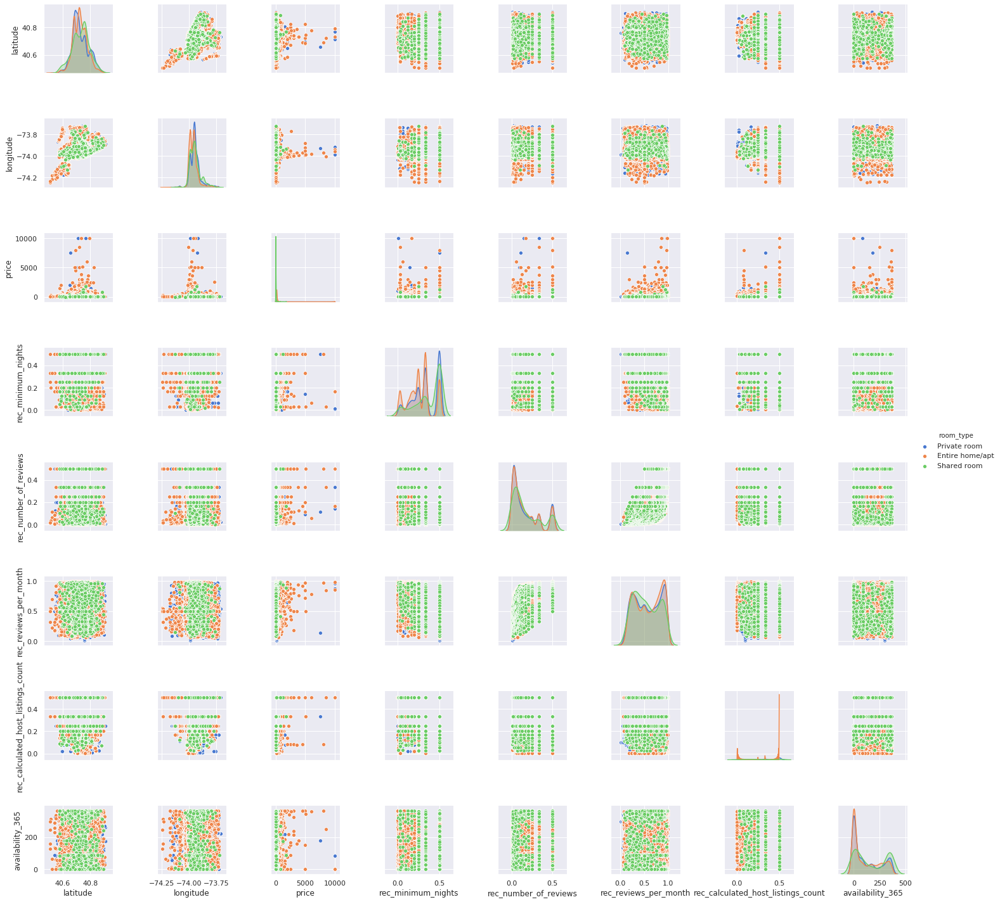

In [43]:
sns.pairplot(df_wo_rpm,hue='room_type',vars = ['latitude', 'longitude', 'price',
       'rec_minimum_nights', 'rec_number_of_reviews', 
       'rec_reviews_per_month', 'rec_calculated_host_listings_count',
       'availability_365'])

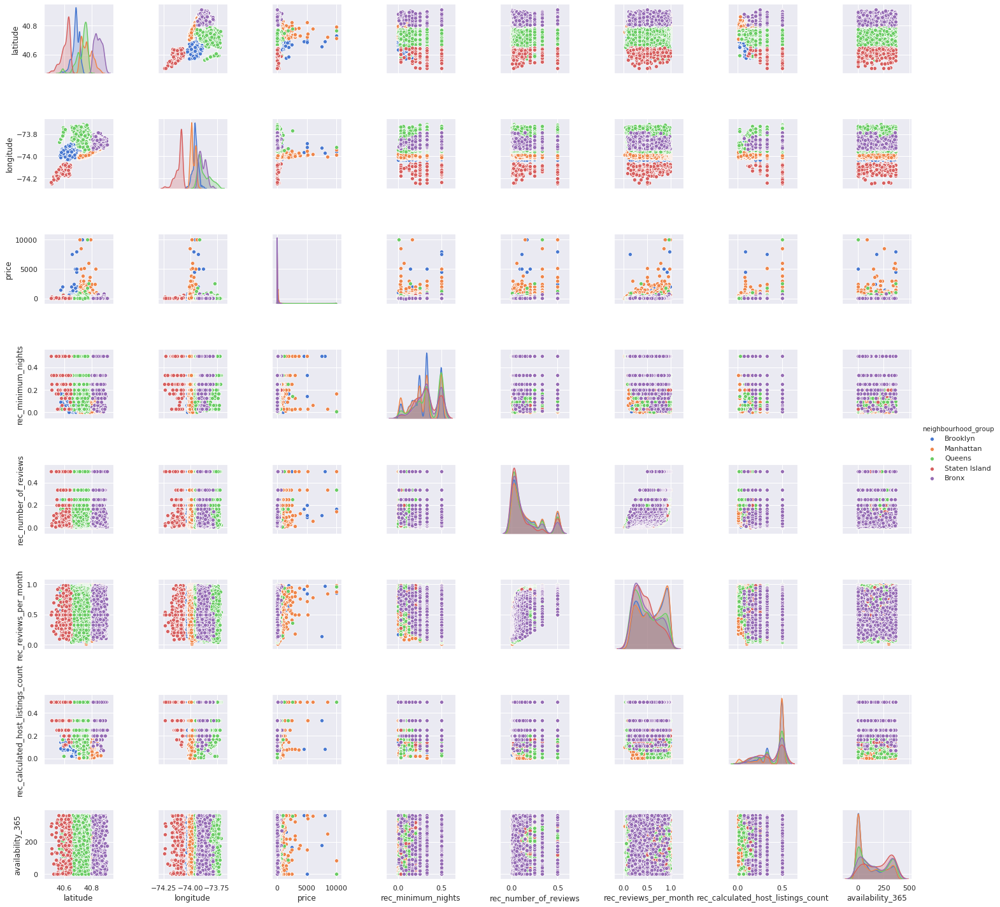

In [44]:
sns.pairplot(df_wo_rpm,hue='neighbourhood_group',vars = ['latitude', 'longitude', 'price',
       'rec_minimum_nights', 'rec_number_of_reviews', 
       'rec_reviews_per_month', 'rec_calculated_host_listings_count',
       'availability_365'])

In [45]:
features1 = ['rec_minimum_nights', 'rec_number_of_reviews', 
       'rec_reviews_per_month', 'rec_calculated_host_listings_count',
       'availability_365']

In [46]:
X1 = df_wo_rpm[features1]

In [47]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y, test_size = 0.2, random_state = 42)

In [48]:
LR_raw1 = LinearRegression(normalize=False)
LR_norm1 = LinearRegression(normalize=True)

In [49]:
LR_raw1.fit(X_train1,y_train1)
LR_norm1.fit(X_train1,y_train1)
score_LR_raw1 = LR_raw1.score(X_test1,y_test1)
score_LR_norm1 = LR_norm1.score(X_test1,y_test1)
print('Scoring Linear regression with no normalisation with reciprocal transformation:', score_LR_raw1)
print('Scoring Linear regression with normalisation with reciprocal transformation:', score_LR_norm1)

Scoring Linear regression with no normalisation with reciprocal transformation: 0.015426158014832492
Scoring Linear regression with normalisation with reciprocal transformation: 0.01542615801483238


In [50]:
df1_corr = df_wo_rpm.corr()
df1_corr

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,count,rec_minimum_nights,rec_number_of_reviews,rec_reviews_per_month,rec_calculated_host_listings_count
id,1.000000,0.591480,-0.010085,0.103336,-0.006696,-0.073937,-0.330019,0.291786,0.098446,0.006624,NaN,0.150810,0.226969,-0.352272,-0.097436
host_id,0.591480,1.000000,0.012823,0.141276,0.006263,-0.051673,-0.141973,0.296274,0.149417,0.155361,NaN,0.172367,0.069707,-0.319660,-0.157620
latitude,-0.010085,0.012823,1.000000,0.088259,0.031344,0.024893,-0.008559,-0.010117,0.004340,-0.021921,NaN,-0.010906,0.012516,0.020269,0.001637
longitude,0.103336,0.141276,0.088259,1.000000,-0.155298,-0.055414,0.054746,0.146228,-0.093348,0.102573,NaN,0.140052,-0.067201,-0.137713,-0.091167
price,-0.006696,0.006263,0.031344,-0.155298,1.000000,0.025501,-0.035924,-0.030623,0.052895,0.078276,NaN,-0.055380,0.027051,0.023799,0.031339
minimum_nights,-0.073937,-0.051673,0.024893,-0.055414,0.025501,1.000000,-0.069366,-0.121712,0.073474,0.101658,NaN,-0.401835,0.077044,0.140644,-0.119567
number_of_reviews,-0.330019,-0.141973,-0.008559,0.054746,-0.035924,-0.069366,1.000000,0.549699,-0.059796,0.193409,NaN,0.163198,-0.496565,-0.543514,-0.036513
reviews_per_month,0.291786,0.296274,-0.010117,0.146228,-0.030623,-0.121712,0.549699,1.000000,-0.009442,0.185896,NaN,0.318450,-0.455756,-0.834861,-0.088040
calculated_host_listings_count,0.098446,0.149417,0.004340,-0.093348,0.052895,0.073474,-0.059796,-0.009442,1.000000,0.182981,NaN,-0.088608,0.069356,-0.007325,-0.407456
availability_365,0.006624,0.155361,-0.021921,0.102573,0.078276,0.101658,0.193409,0.185896,0.182981,1.000000,NaN,-0.033320,-0.179498,-0.263331,-0.385212


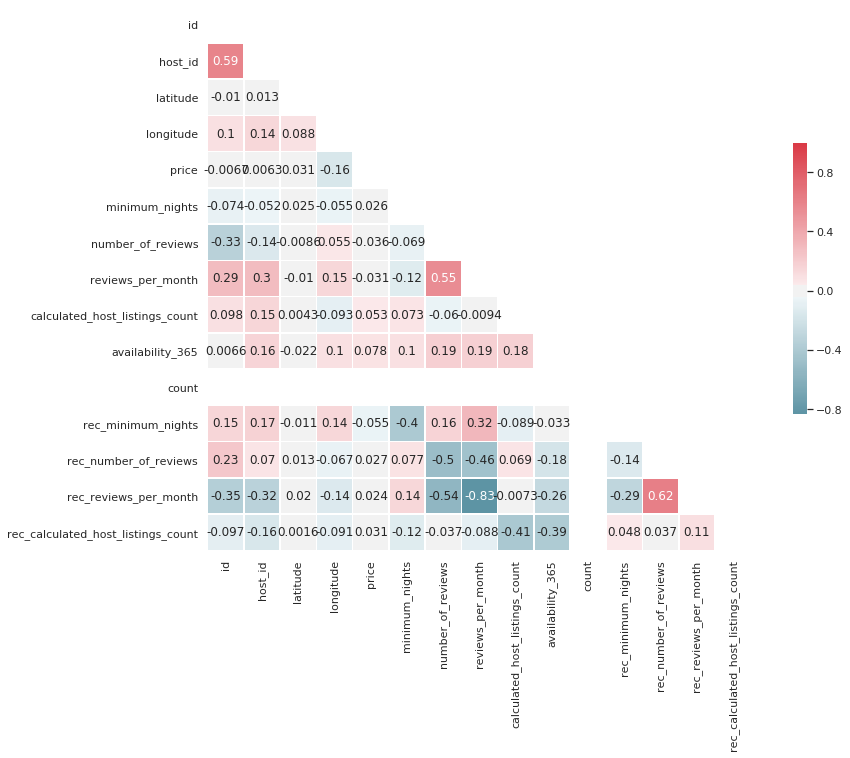

In [51]:
# Copied code from seaborn examples
# https://seaborn.pydata.org/examples/many_pairwise_correlations.html
sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.zeros_like(df1_corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 10))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(df1_corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.show();

In [52]:
mean_lat = np.mean(df_wo_rpm.latitude)
mean_lon = np.mean(df_wo_rpm.longitude)
print('Mean Latitude:',mean_lat)
print('Mean Longitude:',mean_lon)

Mean Latitude: 40.72812912547333
Mean Longitude: -73.95114881816544


In [53]:
df_wo_rpm['latdist_fromcen'] =  df.apply(lambda row: (row.latitude-np.mean(df_wo_rpm.latitude)), axis = 1) 
df_wo_rpm['londist_fromcen'] =  df.apply(lambda row: (row.longitude-np.mean(df_wo_rpm.longitude)), axis = 1)

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



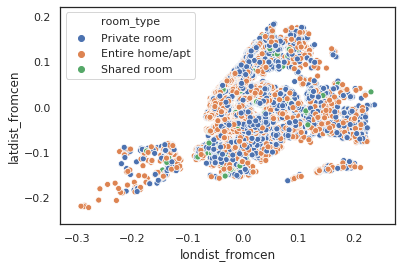

In [54]:
sns.scatterplot(x='londist_fromcen',y='latdist_fromcen',data=df_wo_rpm,hue='room_type')
plt.legend(loc='upper left')

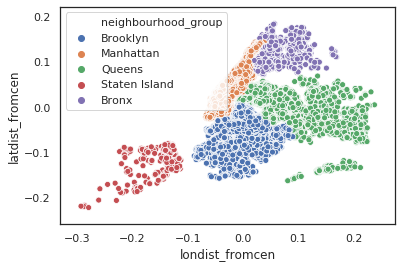

In [55]:
sns.scatterplot(x='londist_fromcen',y='latdist_fromcen',data=df_wo_rpm,hue='neighbourhood_group')
plt.legend(loc='upper left')

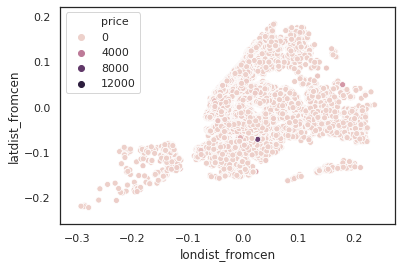

In [56]:
sns.scatterplot(x='londist_fromcen',y='latdist_fromcen',data=df_wo_rpm,hue='price')
plt.legend(loc='upper left')

In [57]:
fig = px.scatter(df_wo_rpm, x="londist_fromcen", y="latdist_fromcen", color=np.log10(df_wo_rpm["price"]), hover_name="room_type")
#https://plot.ly/python/colorscales/#customizing-tick-text-on-logarithmic-color-bars
fig.update_layout(coloraxis_colorbar=dict(
    title="Price",
    #tickvals=[6,7,8,9],
    ticktext=["10", "100", "100M", "1B"],
))
fig.show()

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/pandas/core/series.py:856: RuntimeWarning:

divide by zero encountered in log10



No handles with labels found to put in legend.


(1.0, 100000.0)

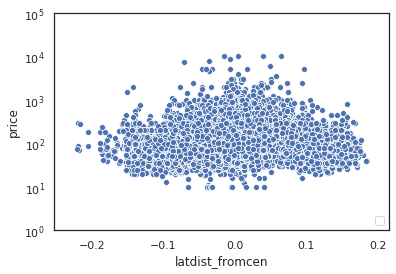

In [58]:
sns.scatterplot(x='latdist_fromcen',y='price',data=df_wo_rpm)
plt.legend(loc='lower right')
plt.yscale('log')
plt.ylim(1e-0, 1e5)

No handles with labels found to put in legend.


(1.0, 100000.0)

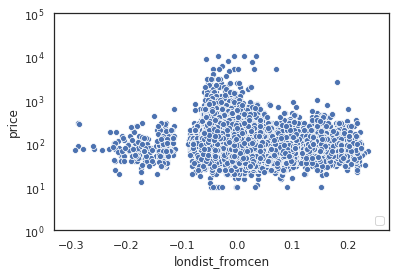

In [59]:
sns.scatterplot(x='londist_fromcen',y='price',data=df_wo_rpm)
plt.legend(loc='lower right')
plt.yscale('log')
plt.ylim(1e-0, 1e5)

In [60]:
(df_wo_rpm == 0).sum(axis=0)

id                                        0
name                                      0
host_id                                   0
host_name                                 0
neighbourhood_group                       0
neighbourhood                             0
latitude                                  0
longitude                                 0
room_type                                 0
price                                    10
minimum_nights                            0
number_of_reviews                         0
last_review                               0
reviews_per_month                         0
calculated_host_listings_count            0
availability_365                      12675
count                                     0
rec_minimum_nights                        0
rec_number_of_reviews                     0
rec_reviews_per_month                     0
rec_calculated_host_listings_count        0
latdist_fromcen                           0
londist_fromcen                 

Split using dummies the cities, do kde plot then finally do some dimensional feature selection with r^2 analysis done.

In [61]:
df_wo_rpm_dummies = pd.get_dummies(data = df_wo_rpm, columns = ['neighbourhood_group','room_type'], 
                                      prefix = ['neighbourhood_group','room_type'] )
df_wo_rpm_dummies.head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,price,minimum_nights,number_of_reviews,...,latdist_fromcen,londist_fromcen,neighbourhood_group_Bronx,neighbourhood_group_Brooklyn,neighbourhood_group_Manhattan,neighbourhood_group_Queens,neighbourhood_group_Staten Island,room_type_Entire home/apt,room_type_Private room,room_type_Shared room
0,2539,Clean & quiet apt home by the park,2787,John,Kensington,40.64749,-73.97237,149,1,9,...,-0.080639,-0.021221,0,1,0,0,0,0,1,0
1,2595,Skylit Midtown Castle,2845,Jennifer,Midtown,40.75362,-73.98377,225,1,45,...,0.025491,-0.032621,0,0,1,0,0,1,0,0
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Clinton Hill,40.68514,-73.95976,89,1,270,...,-0.042989,-0.008611,0,1,0,0,0,1,0,0
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,East Harlem,40.79851,-73.94399,80,10,9,...,0.070381,0.007159,0,0,1,0,0,1,0,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Murray Hill,40.74767,-73.97500,200,3,74,...,0.019541,-0.023851,0,0,1,0,0,1,0,0


In [62]:
df_wo_rpm_dummies.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'price', 'minimum_nights', 'number_of_reviews',
       'last_review', 'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'count', 'rec_minimum_nights',
       'rec_number_of_reviews', 'rec_reviews_per_month',
       'rec_calculated_host_listings_count', 'latdist_fromcen',
       'londist_fromcen', 'neighbourhood_group_Bronx',
       'neighbourhood_group_Brooklyn', 'neighbourhood_group_Manhattan',
       'neighbourhood_group_Queens', 'neighbourhood_group_Staten Island',
       'room_type_Entire home/apt', 'room_type_Private room',
       'room_type_Shared room'],
      dtype='object')

In [63]:
df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Bronx']==1].price

171       40
207       45
261      105
309       90
433       77
        ... 
48068     60
48075     79
48146     40
48340     85
48805    100
Name: price, Length: 875, dtype: int64

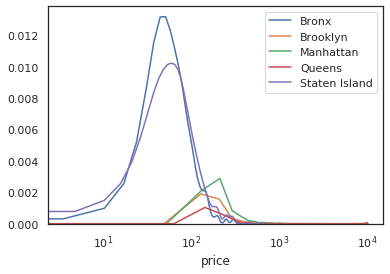

In [64]:
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Bronx']==1].price,label='Bronx')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Brooklyn']==1].price,label='Brooklyn')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Manhattan']==1].price,label='Manhattan')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Queens']==1].price,label='Queens')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Staten Island']==1].price,label='Staten Island')
plt.xscale('log')
plt.xlabel('price')
plt.legend(loc='best')
plt.show()

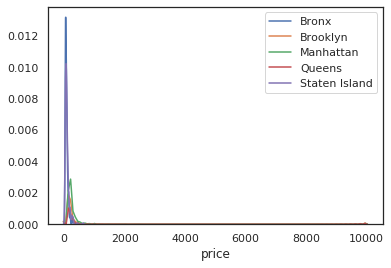

In [65]:
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Bronx']==1].price,label='Bronx')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Brooklyn']==1].price,label='Brooklyn')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Manhattan']==1].price,label='Manhattan')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Queens']==1].price,label='Queens')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['neighbourhood_group_Staten Island']==1].price,label='Staten Island')
plt.xlabel('price')
plt.legend(loc='best')
plt.show()

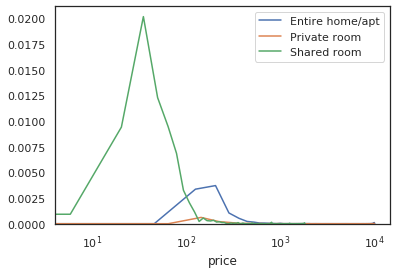

In [66]:
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['room_type_Entire home/apt']==1].price,label='Entire home/apt')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['room_type_Private room']==1].price,label='Private room')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['room_type_Shared room']==1].price,label='Shared room')
plt.xscale('log')
plt.xlabel('price')
plt.legend(loc='best')
plt.show()

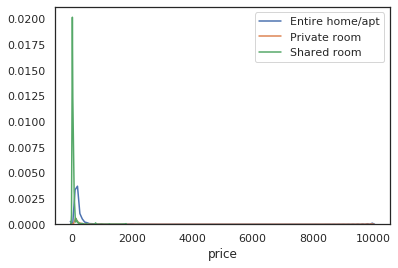

In [67]:
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['room_type_Entire home/apt']==1].price,label='Entire home/apt')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['room_type_Private room']==1].price,label='Private room')
sns.kdeplot(df_wo_rpm_dummies[df_wo_rpm_dummies['room_type_Shared room']==1].price,label='Shared room')
plt.xlabel('price')
plt.legend(loc='best')
plt.show()

Fit a gaussion curve using regression. It is clearly not linear and I do not believe constantly massaging the data will get a linear fit. How do you fit a gaussian like we do in Physics?
$$A\exp(-(x_1+x_2+...+x_n)^2)+B\exp(-(y_1+y_2+...+y_n)^2)+...$$

Will do some EDA then try linear regression after applying a log transformation to the price variable.

In [68]:
df_wo_rpm_dummies['log_price'] =  df_wo_rpm_dummies.apply(lambda row: (np.log(row.price)), axis = 1) 

/home/pug/data_science/DSIA/VE/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning:

divide by zero encountered in log



In [69]:
df2 = df_wo_rpm_dummies.corr()
df2

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,...,londist_fromcen,neighbourhood_group_Bronx,neighbourhood_group_Brooklyn,neighbourhood_group_Manhattan,neighbourhood_group_Queens,neighbourhood_group_Staten Island,room_type_Entire home/apt,room_type_Private room,room_type_Shared room,log_price
id,1.000000,0.591480,-0.010085,0.103336,-0.006696,-0.073937,-0.330019,0.291786,0.098446,0.006624,...,0.103336,0.047768,-0.044699,-0.034174,0.092040,0.024982,-0.071317,0.054984,0.056436,-0.043065
host_id,0.591480,1.000000,0.012823,0.141276,0.006263,-0.051673,-0.141973,0.296274,0.149417,0.155361,...,0.141276,0.073060,-0.107732,-0.011210,0.137745,0.039454,-0.080735,0.059299,0.073936,-0.036505
latitude,-0.010085,0.012823,1.000000,0.088259,0.031344,0.024893,-0.008559,-0.010117,0.004340,-0.021921,...,0.088259,0.331894,-0.675340,0.595500,0.021608,-0.192003,-0.022927,0.019857,0.010705,0.065971
longitude,0.103336,0.141276,0.088259,1.000000,-0.155298,-0.055414,0.054746,0.146228,-0.093348,0.102573,...,1.000000,0.218768,0.002213,-0.421572,0.625606,-0.297229,-0.179545,0.172410,0.026177,-0.326181
price,-0.006696,0.006263,0.031344,-0.155298,1.000000,0.025501,-0.035924,-0.030623,0.052895,0.078276,...,-0.155298,-0.048389,-0.090792,0.165766,-0.086335,-0.024005,0.287209,-0.270497,-0.059947,0.643903
minimum_nights,-0.073937,-0.051673,0.024893,-0.055414,0.025501,1.000000,-0.069366,-0.121712,0.073474,0.101658,...,-0.055414,-0.016912,-0.027061,0.056938,-0.034601,-0.012717,0.073259,-0.069778,-0.012625,0.019322
number_of_reviews,-0.330019,-0.141973,-0.008559,0.054746,-0.035924,-0.069366,1.000000,0.549699,-0.059796,0.193409,...,0.054746,0.009743,0.005055,-0.035339,0.038126,0.013990,-0.016432,0.022412,-0.020225,-0.024615
reviews_per_month,0.291786,0.296274,-0.010117,0.146228,-0.030623,-0.121712,0.549699,1.000000,-0.009442,0.185896,...,0.146228,0.042052,-0.045838,-0.052254,0.123657,0.026836,-0.041489,0.039049,0.008749,-0.039404
calculated_host_listings_count,0.098446,0.149417,0.004340,-0.093348,0.052895,0.073474,-0.059796,-0.009442,1.000000,0.182981,...,-0.093348,-0.017094,-0.095568,0.118676,-0.025159,-0.009538,0.074628,-0.074183,-0.002287,0.101617
availability_365,0.006624,0.155361,-0.021921,0.102573,0.078276,0.101658,0.193409,0.185896,0.182981,1.000000,...,0.102573,0.065909,-0.059802,-0.037049,0.100612,0.063270,-0.028564,0.011380,0.058898,0.077677


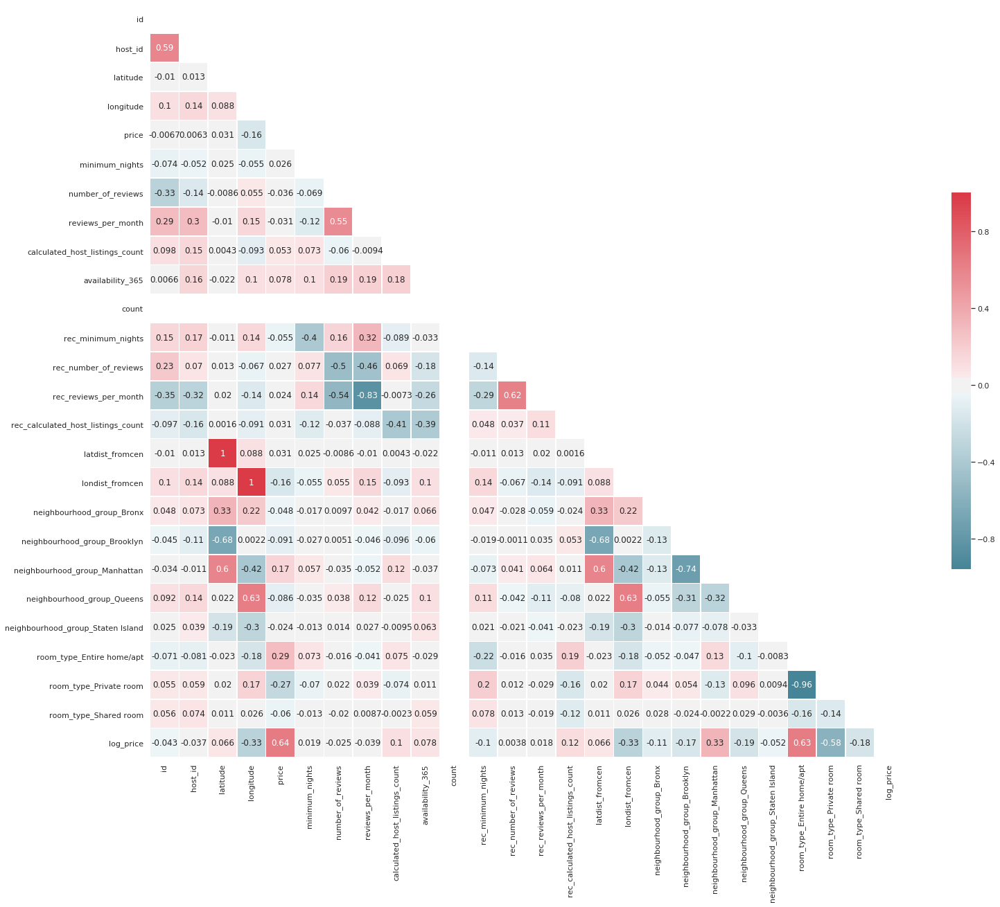

In [70]:
# Copied code from seaborn examples
# https://seaborn.pydata.org/examples/many_pairwise_correlations.html
sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.zeros_like(df2, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(df2, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.show();

In [71]:
df_wo_rpm_dummies.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'price', 'minimum_nights', 'number_of_reviews',
       'last_review', 'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'count', 'rec_minimum_nights',
       'rec_number_of_reviews', 'rec_reviews_per_month',
       'rec_calculated_host_listings_count', 'latdist_fromcen',
       'londist_fromcen', 'neighbourhood_group_Bronx',
       'neighbourhood_group_Brooklyn', 'neighbourhood_group_Manhattan',
       'neighbourhood_group_Queens', 'neighbourhood_group_Staten Island',
       'room_type_Entire home/apt', 'room_type_Private room',
       'room_type_Shared room', 'log_price'],
      dtype='object')

In [72]:
features = ['longitude','latitude','minimum_nights', 'number_of_reviews', 
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'neighbourhood_group_Brooklyn', 'neighbourhood_group_Manhattan',
       'neighbourhood_group_Queens', 'neighbourhood_group_Staten Island',
       'room_type_Entire home/apt', 'room_type_Private room',
       'room_type_Shared room']
X=df_wo_rpm_dummies[features]
y=df_wo_rpm_dummies.log_price

In [73]:
X2 = X.fillna(X.mean())

In [74]:
y = y.fillna(y.mean())

In [75]:
from sklearn.impute import SimpleImputer

In [76]:
def replace_missing_value(df, number_features):

    imputer = SimpleImputer(strategy="median")
    df_num = df[number_features]
    imputer.fit(df_num)
    X = imputer.transform(df_num)
    res_def = pd.DataFrame(X, columns=df_num.columns)
    return res_def

In [77]:
X3 = replace_missing_value(X2,features)

In [78]:
def fix_inf(df):
    df[df==np.inf]=np.nan
    df.fillna(df.mean(), inplace=True)
    return df

In [79]:
fix_inf(X3)

,longitude,latitude,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,neighbourhood_group_Brooklyn,neighbourhood_group_Manhattan,neighbourhood_group_Queens,neighbourhood_group_Staten Island,room_type_Entire home/apt,room_type_Private room,room_type_Shared room
0,-73.97237,40.64749,1.0,9.0,0.21,6.0,365.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
1,-73.98377,40.75362,1.0,45.0,0.38,2.0,355.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2,-73.95976,40.68514,1.0,270.0,4.64,1.0,194.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,-73.94399,40.79851,10.0,9.0,0.10,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
4,-73.97500,40.74767,3.0,74.0,0.59,1.0,129.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38816,-73.95366,40.78099,1.0,1.0,1.00,1.0,147.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
38817,-73.81459,40.75104,1.0,1.0,1.00,6.0,339.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
38818,-74.14275,40.54179,1.0,1.0,1.00,1.0,87.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
38819,-73.92400,40.80787,1.0,2.0,2.00,1.0,40.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [80]:
fix_inf(y)

0        5.003946
1        5.416100
3        4.488636
4        4.382027
5        5.298317
           ...   
48782    4.859812
48790    3.806662
48799    5.459586
48805    4.605170
48852    3.401197
Name: log_price, Length: 38821, dtype: float64

In [81]:
print(X3.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38821 entries, 0 to 38820
Data columns (total 14 columns):
longitude                            38821 non-null float64
latitude                             38821 non-null float64
minimum_nights                       38821 non-null float64
number_of_reviews                    38821 non-null float64
reviews_per_month                    38821 non-null float64
calculated_host_listings_count       38821 non-null float64
availability_365                     38821 non-null float64
neighbourhood_group_Brooklyn         38821 non-null float64
neighbourhood_group_Manhattan        38821 non-null float64
neighbourhood_group_Queens           38821 non-null float64
neighbourhood_group_Staten Island    38821 non-null float64
room_type_Entire home/apt            38821 non-null float64
room_type_Private room               38821 non-null float64
room_type_Shared room                38821 non-null float64
dtypes: float64(14)
memory usage: 4.1 MB
None


In [82]:
LR_raw = LinearRegression(normalize=False)
LR_norm = LinearRegression(normalize=True)

In [83]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X3, y, test_size = 0.2, random_state = 42)

In [84]:
X2.isna().sum()

longitude                            0
latitude                             0
minimum_nights                       0
number_of_reviews                    0
reviews_per_month                    0
calculated_host_listings_count       0
availability_365                     0
neighbourhood_group_Brooklyn         0
neighbourhood_group_Manhattan        0
neighbourhood_group_Queens           0
neighbourhood_group_Staten Island    0
room_type_Entire home/apt            0
room_type_Private room               0
room_type_Shared room                0
dtype: int64

In [85]:
y.isna().sum()

0

In [86]:
X3.replace([np.inf, -np.inf], np.nan, inplace=True)

In [87]:
X3.fillna(X3.mean(), inplace=True)

In [88]:
y.replace([np.inf, -np.inf], np.nan, inplace=True)

In [89]:
y.fillna(y.mean(), inplace=True)

In [90]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X3, y, test_size = 0.2, random_state = 42)

In [99]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X3, y, test_size = 0.2, random_state = 5555)

In [91]:
X3.shape

(38821, 14)

In [92]:
y.shape

(38821,)

In [93]:
LR_raw.fit(X_train2,y_train2)
LR_norm.fit(X_train2,y_train2)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=True)

In [94]:
X_test2.shape

(7765, 14)

In [95]:
score_LR_raw2 = LR_raw.score(X_test2,y_test2)
score_LR_norm2 = LR_norm.score(X_test2,y_test2)
print('Scoring Linear regression with no normalisation for log(price):', score_LR_raw2)
print('Scoring Linear regression with normalisation for log(price):', score_LR_norm2)

Scoring Linear regression with no normalisation for log(price): 0.5303210077347896
Scoring Linear regression with normalisation for log(price): 0.5303210077347906


In [96]:
show_steps = True

In [100]:
## Use Forward Feature Selection to pick a good model

# start with no predictors
included = []
# keep track of model and parameters
best = {'feature': '', 'r2': 0, 'a_r2': 0}
# create a model object to hold the modelling parameters
model = LinearRegression()
# get the number of cases in the test data
n = X_test2.shape[0]

r2_list = []
adjusted_r2_list = []

while True:
    changed = False
    
    if show_steps:
        print('') 

    # list the features to be evaluated
    excluded = list(set(X3.columns) - set(included))
    
    if show_steps:
        print('(Step) Excluded = %s' % ', '.join(excluded))  

    # for each remaining feature to be evaluated
    for new_column in excluded:
        
        if show_steps:
            print('(Step) Trying %s...' % new_column)
            print('(Step) - Features = %s' % ', '.join(included + [new_column]))

        # fit the model with the Training data
        fit = model.fit(X_train2,y_train2) # fit a model; consider which predictors should be included
        # calculate the score (R^2 for Regression)
        r2 = fit.score(X_test2,y_test2) # calculate the score
        r2_list.append(r2)
        # number of predictors in this model
        k = len(included) + 1
        # calculate the adjusted R^2
        adjusted_r2 = 1-(((1-r2)*(n-1))/(n-k-1)) # calculate the Adjusted R^2
        adjusted_r2_list.append(adjusted_r2)

        if show_steps:
            print('(Step) - Adjusted R^2: This = %.3f; Best = %.3f' % 
                  (adjusted_r2, best['a_r2']))

        # if model improves
        if adjusted_r2 > best['a_r2']:
            # record new parameters
            best = {'feature': new_column, 'r2': r2, 'a_r2': adjusted_r2}
            # flag that found a better model
            changed = True
            if show_steps:
                print('(Step) - New Best!   : Feature = %s; R^2 = %.3f; Adjusted R^2 = %.3f' % 
                      (best['feature'], best['r2'], best['a_r2']))
    # END for

    # if found a better model after testing all remaining features
    if changed:
        # update control details
        included.append(best['feature'])
        excluded = list(set(excluded) - set(best['feature']))
        print('Added feature %-4s with R^2 = %.3f and adjusted R^2 = %.3f' % 
              (best['feature'], best['r2'], best['a_r2']))
    else:
        # terminate if no better model
        break

print('')
print('Resulting features:')
print(', '.join(included))



(Step) Excluded = reviews_per_month, neighbourhood_group_Queens, minimum_nights, room_type_Shared room, neighbourhood_group_Brooklyn, neighbourhood_group_Manhattan, room_type_Entire home/apt, room_type_Private room, calculated_host_listings_count, availability_365, number_of_reviews, longitude, latitude, neighbourhood_group_Staten Island
(Step) Trying reviews_per_month...
(Step) - Features = reviews_per_month
(Step) - Adjusted R^2: This = 0.497; Best = 0.000
(Step) - New Best!   : Feature = reviews_per_month; R^2 = 0.497; Adjusted R^2 = 0.497
(Step) Trying neighbourhood_group_Queens...
(Step) - Features = neighbourhood_group_Queens
(Step) - Adjusted R^2: This = 0.497; Best = 0.497
(Step) Trying minimum_nights...
(Step) - Features = minimum_nights
(Step) - Adjusted R^2: This = 0.497; Best = 0.497
(Step) Trying room_type_Shared room...
(Step) - Features = room_type_Shared room
(Step) - Adjusted R^2: This = 0.497; Best = 0.497
(Step) Trying neighbourhood_group_Brooklyn...
(Step) - Featur

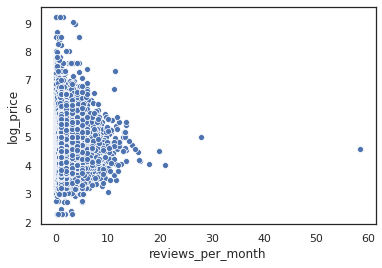

In [102]:
sns.scatterplot(x=X3.reviews_per_month,y=y)

This project has been trying various methods to improve the linearity on the data. In the end, the data is simply non-linear and non linear methods need to apply to this data set to improve the result. I did improve the initial r^2 from 0.01 to 0.5 but given it is only one feature (reviews per month), cannot draw any strong conclusions with this model. I think I will come back to this dataset at some point once have more experience dealing with non linear cases.